<a href="https://colab.research.google.com/github/Maxxx-VS/The-Founder/blob/master/Neuro_employee_%2B_GPT.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

1. Определись с "профессией" нейро-сотрудника, его "внутренним миром", каким "инструкциям" он должен следовать - это поможет в реализации системного промпта для нейро-сотрудника.
2. Подумай над базой знаний для нейро-сотрудника, ее структурой и данными. Удели отдельное внимание данным.
3. Определись с фреймворком для реализации нейро-сотрудника (LlamaIndex или LangChain).
4. Желательно задействовать контурную русскоязычную LLM.
5. Проведи трассировку работы нейро-сотрудника, выяви его слабые стороны и "симптомы" галлюцинаций.
6. Победи галлюцинации, если они обнаружены.
7. Если галлюцинации не обнаружены подумай, где они потенциально возможны в твоей RAG-системе и воспользуйся приемами из уроков.
8. Задействуй несколько приемов улучшения RAG. Помни, что на Хабре много статей по нейро-сотрудникам, и они хорошо известны, поэтому простое решение (похожее на остальные) не заинтересует работодателя.
9. Подумай о безопасности нейро-сотрудника, про фильтрацию запросов к нему, хотя бы самую простую.

## Кратко про практическую работу:


*   Профессия этого нейро-сотрудника - эксперт/консультант по трудовому праву РФ.
*   Базой для нейро-сотрудника является трудовой кодекс РФ. Который сам по себе разбит и пронумерован на разделы/главы/статьи.
*   Фреймворк на котором реализован нейро-сотрудник - LlamaIndex т.к. он предоставляет удобные инструменты для работы с большими языковыми моделями и позволяет индексировать большие объемы текстовых данных, а также выполнять по ним эффективный поиск.
*   Задействовать контурную русскоязычную LLM - не получилось. Я изначально взял её, но за день до сдачи этой работы товарищи обновили библиотеки и они теперь конфликтуют.
*   Мой нейро-сотрудник работает не идеально. Он иногда отвечает на английском языке (это ожидаемо от gpt-3.5-turbo). На общие вопросы отвечает достаточно точно. На очень узкие вопросы дает ложные ответы. Вероятно это ущербность подхода. С LoRa получается точнее.
*   В части галлюцинаций - на явно кривой впорос "Как приготовить банановые морковки?" отвечает "Empty Response". Но иногда бывет, что его пробивает на галлюцинации и он пишет про маффины.
*   Применил при формировании движка запросов 5 близких ответов (Болевая точка 2) и параллельную обработку конвейера приема (Болеая точка 8).
*   Про безопасность: я создал словарь, в нем из языка запросов SQL накидал слов, которые применяют злоумышленники для SQL-инъекций. А еще ограничил длину вопроса до 50 символов.
*   Креативность - каждый запрос генерирует тематичекую картинку при помощи Stable Diffusion. Так клиенту будет веселей изучать ответы нейро-сотрудника



In [24]:
!pip install openai
!pip install llama-index-core "arize-phoenix[evals,llama-index]"
!pip install gcsfs nest-asyncio "openinference-instrumentation-llama-index>=2.0.0"
!pip install llama_index --upgrade

!pip install jax==0.4.27 jaxlib==0.4.27
!pip -q install diffusers
!pip -q install transformers scipy ftfy accelerate
!pip -q install "ipywidgets>=7,<8"

  Using cached llama_index-0.11.0-py3-none-any.whl.metadata (11 kB)
  Using cached llama_index_agent_openai-0.3.4-py3-none-any.whl.metadata (728 bytes)
  Using cached llama_index_cli-0.3.1-py3-none-any.whl.metadata (1.5 kB)
  Using cached llama_index_core-0.11.0.post1-py3-none-any.whl.metadata (2.4 kB)
  Using cached llama_index_embeddings_openai-0.2.5-py3-none-any.whl.metadata (686 bytes)
  Using cached llama_index_llms_openai-0.2.16-py3-none-any.whl.metadata (3.3 kB)
  Using cached llama_index_multi_modal_llms_openai-0.2.3-py3-none-any.whl.metadata (729 bytes)
  Using cached llama_index_program_openai-0.2.0-py3-none-any.whl.metadata (766 bytes)
  Using cached llama_index_question_gen_openai-0.2.0-py3-none-any.whl.metadata (785 bytes)
  Using cached llama_index_readers_file-0.2.2-py3-none-any.whl.metadata (5.4 kB)
INFO: pip is looking at multiple versions of llama-index-llms-openai to determine which version is compatible with other requirements. This could take a while.
  Using cache

In [25]:
import getpass, os, nest_asyncio, phoenix as px, openai, torch

from openinference.instrumentation.llama_index import LlamaIndexInstrumentor
from opentelemetry.exporter.otlp.proto.http.trace_exporter import OTLPSpanExporter
from opentelemetry.sdk.trace import TracerProvider
from opentelemetry.sdk.trace.export import SimpleSpanProcessor
from phoenix.session.evaluation import get_qa_with_reference, get_retrieved_documents
from phoenix.trace import DocumentEvaluations, SpanEvaluations
from phoenix.evals import (
    HallucinationEvaluator,
    OpenAIModel,
    QAEvaluator,
    RelevanceEvaluator,
    run_evals,)
from llama_index.llms.openai import OpenAI
from llama_index.embeddings.openai import OpenAIEmbedding
from llama_index.core import (
    VectorStoreIndex,
    GPTVectorStoreIndex,
    SimpleDirectoryReader,
    KeywordTableIndex,
    StorageContext,
    load_index_from_storage,
    ServiceContext,
    Settings,)

In [26]:
from diffusers import StableDiffusionPipeline
from PIL import Image
from google.colab import output

In [27]:
output.enable_custom_widget_manager()
stableDiffusion = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4", revision="fp16", torch_dtype=torch.float16)
stableDiffusion = stableDiffusion.to("cuda")

def createImagesStableDiffusion(prompt='', rows=2, cols=2, iteration=20):
    images =  stableDiffusion([prompt] * (rows*cols), num_inference_steps=iteration).images
    w, h = images[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(images):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    display(grid)

/usr/local/lib/python3.10/dist-packages/diffusers/pipelines/pipeline_loading_utils.py:221: FutureWarning: You are loading the variant fp16 from CompVis/stable-diffusion-v1-4 via `revision='fp16'` even though you can load it via `variant=`fp16`. Loading model variants via `revision='fp16'` is deprecated and will be removed in diffusers v1. Please use `variant='fp16'` instead.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
/usr/local/lib/python3.10/dist-packages/transformers/models/clip/feature_extraction_clip.py:28

In [29]:
os.environ["OPENAI_API_KEY"] = getpass.getpass("Введите OpenAI API Key:")

Введите OpenAI API Key:··········


In [6]:
nest_asyncio.apply()
session = px.launch_app()

🌍 To view the Phoenix app in your browser, visit https://fpy109m5usn3-496ff2e9c6d22116-6006-colab.googleusercontent.com/
📖 For more information on how to use Phoenix, check out https://docs.arize.com/phoenix


In [7]:
endpoint = "http://127.0.0.1:6006/v1/traces"
tracer_provider = TracerProvider()
tracer_provider.add_span_processor(SimpleSpanProcessor(OTLPSpanExporter(endpoint)))
LlamaIndexInstrumentor().instrument(skip_dep_check=True, tracer_provider=tracer_provider)

!unzip -qo "trudkod.zip" -d ./reports

documents = SimpleDirectoryReader('./reports').load_data()
Settings.llm = OpenAI(temperature=0, model='gpt-3.5-turbo')

index = GPTVectorStoreIndex.from_documents(documents)
query_engine = index.as_query_engine()

In [14]:
intro = ("Привет! Я - нейро-сотрудник, который поможет тебе разобраться в тонкостях ТК РФ.")
sql_base = ['drop', 'admin', 'password', 'select', 'union', 'group', 'where']

Привет! Я - нейро-сотрудник, который поможет тебе разобраться в тонкостях ТК РФ.
Задай мне вопрос (для выхода нажми 'q'): Что такое отпуск?

Отпуск - это период времени, когда работник отдыхает от работы и обычно имеет право на определенное вознаграждение или компенсацию за это время.


  0%|          | 0/100 [00:00<?, ?it/s]

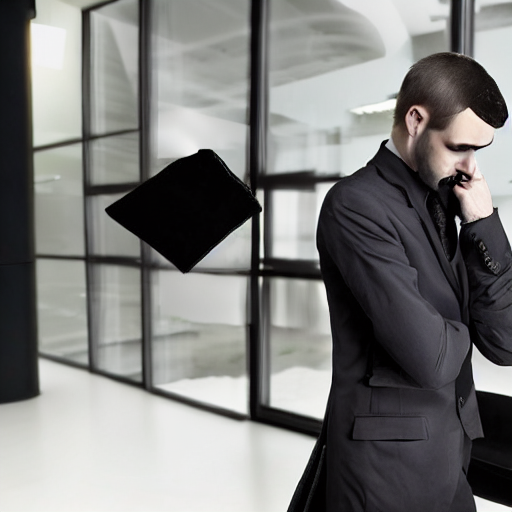

Задай мне вопрос (для выхода нажми 'q'): О чем гласит 333 статья трудового кодекса?

The 333rd article of the Labor Code typically covers regulations related to labor discipline, including rules and procedures for disciplinary actions and sanctions in the workplace.


  0%|          | 0/100 [00:00<?, ?it/s]

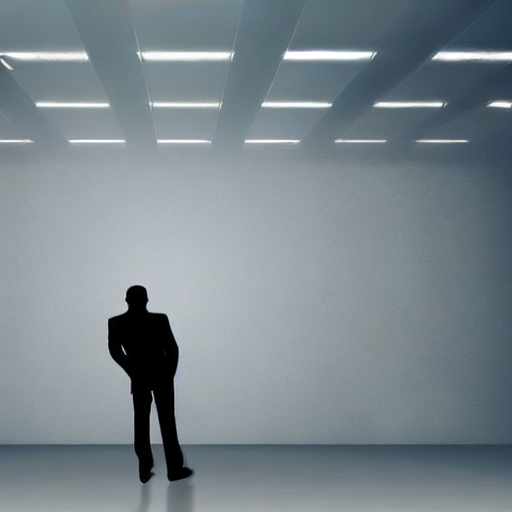

Задай мне вопрос (для выхода нажми 'q'): Как приготовить банановые морковки?

Empty Response


  0%|          | 0/100 [00:00<?, ?it/s]

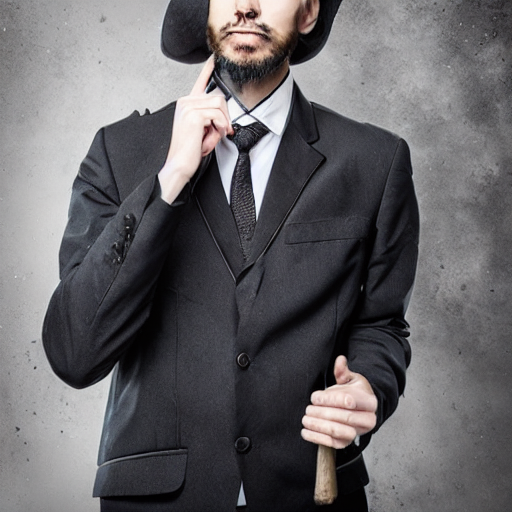

Задай мне вопрос (для выхода нажми 'q'): SELECT * FORM name

The query is not formatted correctly.


  0%|          | 0/100 [00:00<?, ?it/s]

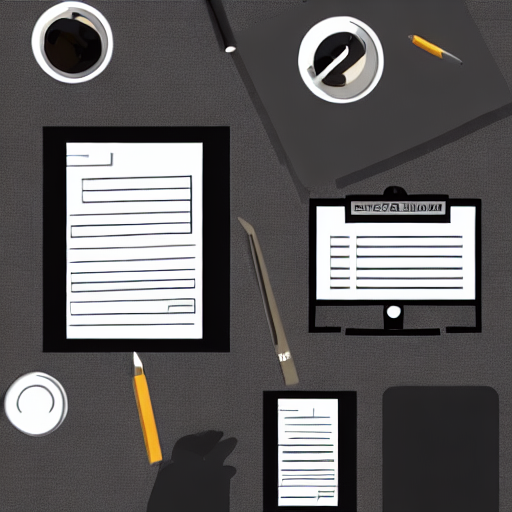

Задай мне вопрос (для выхода нажми 'q'): AdmiN
Вопрос содержит запрещенные слова!
Задай мне вопрос (для выхода нажми 'q'): q


In [16]:
print(intro)
question = ""
while question != 'q':
    question = input("Задай мне вопрос (для выхода нажми 'q'): ")
    if len(question) > 50:
        print("Слишком длинный вопрос. Сформулируй не длинее 50 символов!")
        continue
    if question.lower() in sql_base:
        print("Вопрос содержит запрещенные слова!")
        continue
    if question != 'q':
        response = query_engine.query(question)
        print()
        print(response)
        createImagesStableDiffusion(f'A man is at work, the office, around him {question}, gothic style', 1, 1, 100)
    else:
        break

In [17]:
from llama_index.core import VectorStoreIndex, SimpleDirectoryReader
from llama_index.core.postprocessor import LLMRerank
from llama_index.embeddings.openai import OpenAIEmbedding
from llama_index.llms.openai import OpenAI
from llama_index.core import Settings

In [18]:
index = VectorStoreIndex.from_documents(documents,)

query_engine = index.as_query_engine(
    similarity_top_k=5,
    node_postprocessors=[
        LLMRerank(
            choice_batch_size=5,
            top_n=2,)],)

Привет! Я - нейро-сотрудник, который поможет тебе разобраться в тонкостях ТК РФ.
Задай мне вопрос (для выхода нажми 'q'): Что такое отпуск?

Отпуск - это период времени, когда работник отдыхает от работы и обычных рабочих обязанностей. During this time, employees typically take a break to relax, travel, or engage in leisure activities.


  0%|          | 0/100 [00:00<?, ?it/s]

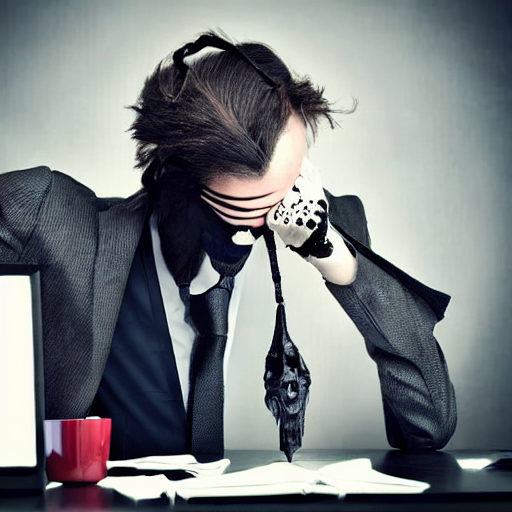

Задай мне вопрос (для выхода нажми 'q'): О чем гласит 333 статья трудового кодекса?

The 333rd article of the Labor Code regulates the termination of an employment contract at the initiative of the employer.


  0%|          | 0/100 [00:00<?, ?it/s]

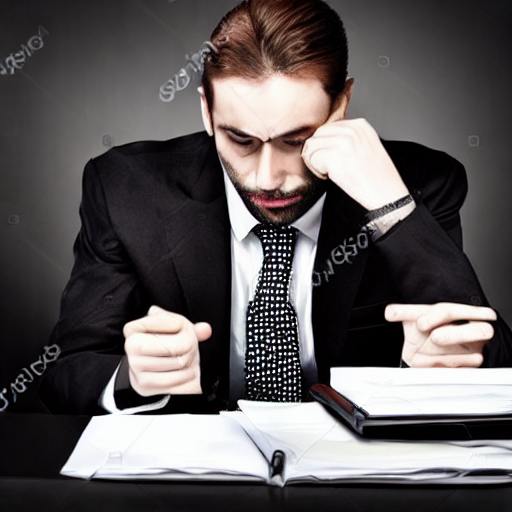

Задай мне вопрос (для выхода нажми 'q'): Как приготовить банановые морковки?

Empty Response


  0%|          | 0/100 [00:00<?, ?it/s]

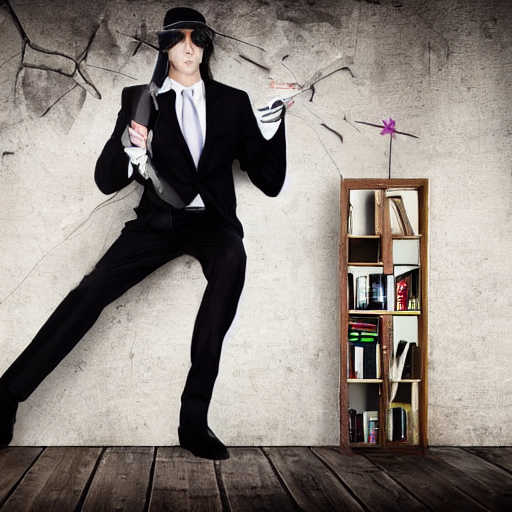

Задай мне вопрос (для выхода нажми 'q'): q


In [19]:
print(intro)
question = ""
while question != 'q':
    question = input("Задай мне вопрос (для выхода нажми 'q'): ")
    if len(question) > 50:
        print("Слишком длинный вопрос. Сформулируй не длинее 50 символов!")
        continue
    if question.lower() in sql_base:
        print("Вопрос содержит запрещенные слова!")
        continue
    if question != 'q':
        response = query_engine.query(question)
        print()
        print(response)
        createImagesStableDiffusion(f'A man is at work, the office, around him {question}, gothic style', 1, 1, 100)
    else:
        break

In [20]:
from IPython.display import Markdown, display
from llama_index.core import Document
from llama_index.embeddings.openai import OpenAIEmbedding
from llama_index.core.node_parser import SentenceSplitter
from llama_index.core.extractors import TitleExtractor
from llama_index.core.ingestion import IngestionPipeline
documents = SimpleDirectoryReader("./reports").load_data()

pipeline = IngestionPipeline(
    transformations=[
        SentenceSplitter(chunk_size=512, chunk_overlap=20),
        TitleExtractor(),
        OpenAIEmbedding(),])

nodes = pipeline.run(documents=documents, num_workers=4)
index = VectorStoreIndex(nodes=nodes)

/usr/local/lib/python3.10/dist-packages/llama_index/core/ingestion/pipeline.py:523: UserWarning: Specified num_workers exceed number of CPUs in the system. Setting `num_workers` down to the maximum CPU count.
  warnings.warn(


Привет! Я - нейро-сотрудник, который поможет тебе разобраться в тонкостях ТК РФ.
Задай мне вопрос (для выхода нажми 'q'): Что такое отпуск?

Отпуск - это период времени, когда работник отдыхает от работы и обычных рабочих обязанностей. During this time, employees typically take a break to relax, travel, or engage in leisure activities.


  0%|          | 0/100 [00:00<?, ?it/s]

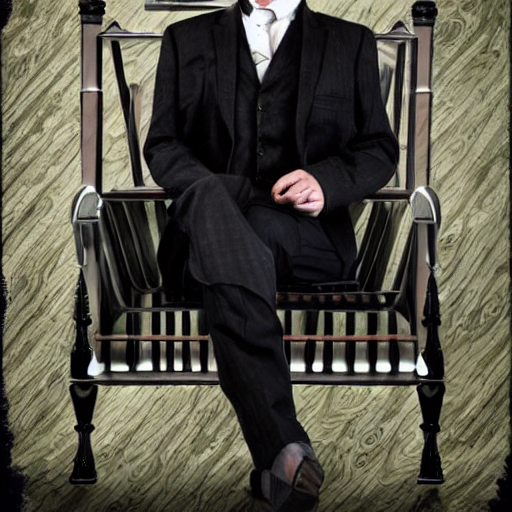

Задай мне вопрос (для выхода нажми 'q'): О чем гласит 333 статья трудового кодекса?

The 333rd article of the Labor Code typically covers regulations related to labor discipline, including rules and procedures for disciplinary actions and sanctions in the workplace.


  0%|          | 0/100 [00:00<?, ?it/s]

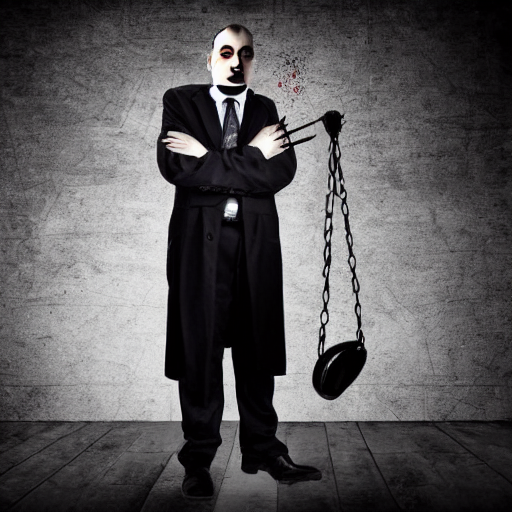

Задай мне вопрос (для выхода нажми 'q'): AdMin
Вопрос содержит запрещенные слова!
Задай мне вопрос (для выхода нажми 'q'): Как приготовить банановые морковки?

Empty Response


  0%|          | 0/100 [00:00<?, ?it/s]

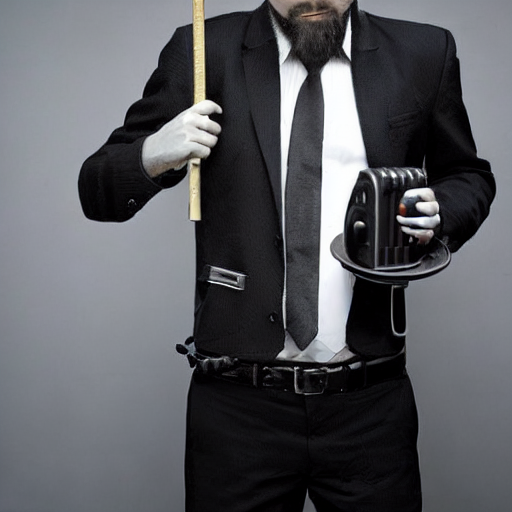

Задай мне вопрос (для выхода нажми 'q'): q


In [23]:
print(intro)
question = ""
while question != 'q':
    question = input("Задай мне вопрос (для выхода нажми 'q'): ")
    if len(question) > 50:
        print("Слишком длинный вопрос. Сформулируй не длинее 50 символов!")
        continue
    if question.lower() in sql_base:
        print("Вопрос содержит запрещенные слова!")
        continue
    if question != 'q':
        response = query_engine.query(question)
        print()
        print(response)
        createImagesStableDiffusion(f'A man is at work, the office, around him {question}, gothic style', 1, 1, 100)
    else:
        break

In [28]:
print(f"Phoenix UI по ссылке: {session.url}")

Phoenix UI по ссылке: https://fpy109m5usn2-496ff2e9c6d22116-6006-colab.googleusercontent.com/
